# Goal of this notebook:

- perform selection cuts on Space Fluff objects.
    - get numbers on how many objects survive selection cuts depending on which objects we select (all, only those classified as galaxies by users, etc.)
    - compare in parameter space the objects that survive selection cuts to the objects in the LGT catalogue, and those in the FDSDC
- create image grids of various subsets of data, 
- manually inspect objects that survive selection cuts and are classified by users as fluffy galaxies, but that don't make it into the final LGT catalogue
    - find objects we believe could still be included
        - extract list of names to put into thesis
        - create image grids to display in thesis

In [1]:
import pandas as pd
import numpy as np
from scipy.stats import linregress as lr
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline

In [2]:
def get_cols(df, cols):
    return df[cols].T.values

def get_column_names(s, df):
    cols = df.columns.tolist()
    return list(filter(lambda x: x.startswith(s), cols))

In [3]:
catalogue_targets = np.loadtxt('../../catalogue/sf_catalogue_targets.txt', dtype='str')
object_info = pd.read_csv('../../catalogue/sf_spacefluff_object_data.csv', comment="#")

In [4]:
object_info.columns

Index(['name', 'RA', 'DEC', 'Reff', 'r_mag', 'g_mag', 'axis_ratio',
       'pos_angle', 'n', 'u', 'g', 'r', 'i', 'ue', 'ge', 're', 'ie', 'Reffe',
       'r_mage', 'ne', 'C', 'mue_r', 'bae', 'RFF'],
      dtype='object')

In [5]:
# df_votes.json is created in ./df_stacked.ipynb. 
#  Make sure to re-run that whenever we change something, 
#   otherwise we'll be working with stale data in this notebook
df_votes = pd.read_json('df_votes.json')
df = pd.read_json('df_stacked.json')

In [6]:
workflows = df['workflow_name'].unique().tolist()
print('Workflows:', workflows)

hc = df.query('workflow_name == @workflows[0]')
classify = df.query('workflow_name == @workflows[1]')
onthego = df.query('workflow_name == @workflows[2]')

Workflows: ['Classify! Hardcore edition', 'Classify!', 'Classify on the go!']


---

# Selection cuts:
One of the goals of this notebook is to perform selection cuts on SpaceFluff objects, using the procedure outlined and performed also in _"The Fornax Deep Survey (FDS) with the VST: IV. A size and magnitude limited catalog of dwarf galaxies in the area of the Fornax cluster"_ (Venhola et al., 2018)

### Theoretical basis:

_Venhola2018, section 8.2_:

    "We identified the cluster galaxies using the following criteria: firstly they become bluer with decreasing luminosity (e.g., Roediger et al. 2017), secondly the surface brightness of the cluster galaxies decreases with decreasing total  luminosity, and thirdly the faint cluster galaxies are less concentrated than the background galaxies (e.g., Misgeld et al.  2009)."

#### Color cut:

_Venhola2018, section 8.2.1_:

    "To calibrate our selection limits, we used the cluster and background galaxies with spectroscopic data. For the color selection we selected the brightest spectroscopically confirmed cluster galaxies11 and exclude all the galaxies that are at least 0.15 mag redder than that, which corresponds to g’-r’ > 0.95 and g’-i’ > 1.35. These limits are ≈3σ of the calibration uncertainties toward red from the color of NGC1399, which means that by this selection limit we are not likely to remove any galaxies with intrinsic colors bluer than that from our sample."

In [7]:
print('Total number of objects in SpaceFluff:', df_votes.shape[0])

Total number of objects in SpaceFluff: 6362


In [8]:
gal75 = df_votes.query('`T0 % galaxy` >= 75')
gal50 = df_votes.query('`T0 % galaxy` >= 50')

In [9]:
print('Total galaxies as per user consensus:', gal75.shape[0])
print('This equates to ~{}% of all objects'.format(round(100*gal75.shape[0]/df_votes.shape[0], 1)))

Total galaxies as per user consensus: 1973
This equates to ~31.0% of all objects


In [10]:
fluf75 = gal75.query('`T1 % fluffy` >= 75')
fluf90 = gal75.query('`T1 % fluffy` >= 90')

In [11]:
print('Total fluffy galaxies as per user consensus:', fluf90.shape[0])
print('This equates to ~{}% of all galaxies (as determined by user consensus)'.format(
    round(100*fluf90.shape[0]/gal75.shape[0]), 1)
)

Total fluffy galaxies as per user consensus: 548
This equates to ~28% of all galaxies (as determined by user consensus)


In [12]:
fluf_too_red = fluf75.query('g-r > 0.95')
fluf_not_too_red = fluf75.query('g-r <= 0.95')

print(fluf_not_too_red.shape[0])
fluf_not_too_red = fluf75.query('g-i <= 1.35')
print(fluf_not_too_red.shape[0])

900
869


In [13]:
print('Galaxies (as per user consensus) redder than g\'-r\' = 0.95 mag:', fluf_too_red.shape[0])
print('This equates to ~{}% of all fluffy galaxies (as per user consensus)'.format(
    round(100*fluf_too_red.shape[0]/fluf90.shape[0], 1))
)

Galaxies (as per user consensus) redder than g'-r' = 0.95 mag: 150
This equates to ~27.4% of all fluffy galaxies (as per user consensus)


In [14]:
fluf_not_too_red.shape[0], \
fluf_too_red.shape[0]

(869, 150)

In [15]:
incatalogue = df_votes.query('name.isin(@catalogue_targets)')

[Text(0.5, 0, "$g'-r'$ [mag]"), Text(0, 0.5, '$\\mu_{e,r}$ [mag arcsec-2]')]

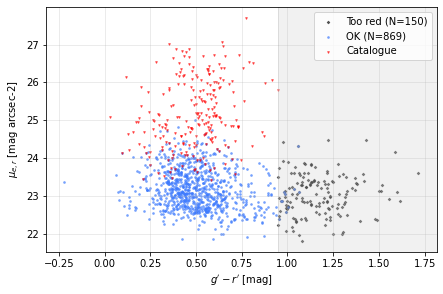

In [16]:
fig, fr = plt.subplots(figsize=(7,4.5))

kw = dict(alpha=0.55, s=3)
fr.scatter(fluf_too_red['g']-fluf_too_red['r'], fluf_too_red['mue_r'], **kw, label='Too red (N={})'.format(fluf_too_red.shape[0]), c='black', marker='D')
fr.scatter(fluf_not_too_red['g']-fluf_not_too_red['r'], fluf_not_too_red['mue_r'], **kw, label='OK (N={})'.format(fluf_not_too_red.shape[0]), c='xkcd:lightish blue')
fr.scatter(incatalogue['g']-incatalogue['r'], incatalogue['mue_r'], **kw, label='Catalogue', c='red', marker='v')
fr.axvline(0.95, lw=0.5, c='grey', alpha=0.3)
fr.axvspan(0.95,2, color='lightgrey', alpha=0.3)

t = fluf75['g']-fluf75['r']
fr.set_xlim(t.min()-0.1, t.max()+0.1)
fr.legend(loc='upper right')
fr.grid(alpha=0.3)
fr.update(dict(xlabel='$g\'-r\'$ [mag]', ylabel=r"$\mu_{e,r}$ [mag arcsec-2]"))
# plt.savefig('./plots/selection/sf90 - color.png', dpi=200, bbox_inches='tight')

#### Surface brightness cut:

_Venhola2018, section 8.2.2_:

    "In order to separate the background galaxies that have higher surface brightness for a given apparent magnitude than the cluster galaxies, we made a linear fit for the cluster galaxies in the magnitude-surface brightness space."

- We will use a linear fit on the catalogue targets (as opposed to Venhola et al., why fit a number of previously spectrally confirmed cluster members), as we are considering those our likely ground truth.

In [17]:
in_catalogue = df_votes.query('name.isin(@catalogue_targets)')

In [18]:
r, mue_r = get_cols(fluf_not_too_red.query('~mue_r.isnull()'), ['r', 'mue_r'])

p = np.polyfit(r, mue_r, 1)

q = [0.645, 9.771]  # good approximation to catalogue
xs = np.linspace(np.min(r), np.max(r), 100)
ys = np.polyval(q, r)

In [19]:
squared_deviations = (r-ys)**2

variance = np.sum(squared_deviations)/(len(squared_deviations)-1)
std = np.sqrt(variance)

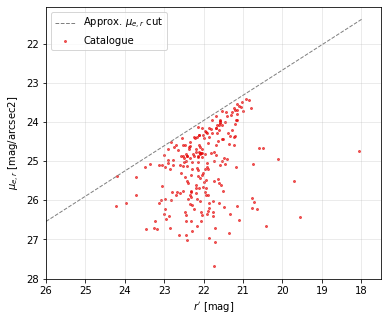

In [20]:
fig, fr = plt.subplots(figsize=(6,5))

kw = dict(s=4, alpha=0.6)

r_cat, mu_cat = get_cols(in_catalogue, ['r', 'mue_r'])
fr.scatter(r_cat, mu_cat, **kw, label='Catalogue', c='xkcd:red')
x = np.linspace(df_votes['r'].min(), df_votes['r'].max(), int(1e3))
fr.plot(x, np.polyval(q, x), label='Approx. $\mu_{e,r}$ cut', lw=1, ls='--', c='grey')
fr.invert_yaxis()
fr.invert_xaxis()
fr.grid(alpha=0.3)
fr.update(dict(
    xlabel='$r\'$ [mag]',
    ylabel="$\mu_{e,r}$ [mag/arcsec2]"
))
fr.set_xlim(26)
fr.legend()

# plt.savefig('./plots/selection/brightness cut.png', dpi=200, bbox_inches='tight')
plt.show()


In [21]:
too_bright = fluf_not_too_red[ys > mue_r]
ok = fluf_not_too_red[ys <= mue_r]

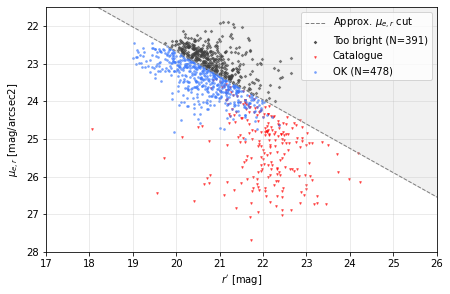

In [22]:
fig, fr = plt.subplots(figsize=(7,4.5))

kw = dict(s=3, alpha=0.55)

fr.scatter(too_bright['r'], too_bright['mue_r'], **kw, label='Too bright (N={})'.format(too_bright.shape[0]), c='black', marker='D')

r_cat, mu_cat = get_cols(in_catalogue, ['r', 'mue_r'])
fr.scatter(r_cat, mu_cat, **kw, label='Catalogue', c='red', marker='v')
fr.scatter(ok['r'], ok['mue_r'], c='xkcd:lightish blue', label='OK (N={})'.format(ok.shape[0]), **kw)

x = np.linspace(df_votes['r'].min(), df_votes['r'].max(), int(1e3))
y = np.polyval(q, x)
fr.plot(x, y, label='Approx. $\mu_{e,r}$ cut', lw=1, ls='--', c='grey')

fr.invert_yaxis()
fr.grid(alpha=0.3)
fr.update(dict(
    xlabel='$r\'$ [mag]',
    ylabel="$\mu_{e,r}$ [mag/arcsec2]"
))
fr.fill_between(x, y, 21, alpha=0.3, color='lightgrey')
fr.set_ylim(28, 21.5)
fr.set_xlim(17, 26)
fr.legend()
# plt.savefig('./plots/selection/sf90 - brightness.png', dpi=200, bbox_inches='tight')
plt.show()


In [23]:
ok.shape[0], fluf_not_too_red.shape[0]

(478, 869)

#### Concentration cut:

_Venhola2018, sec. 8.2.3_:

    "We fit the magnitude-C relation for cluster galaxies with m_r' < 16 mag, and classify the galaxies that are located more than 2σ above that relation, and have C > 3.5, as background galaxies"

In [24]:
survives_cut = ok.query('C >= 0 & C <= 3.5')

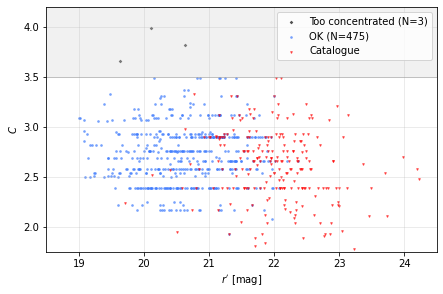

In [25]:
fig, fr = plt.subplots(figsize=(7,4.5))
t = ok.query('C > 3.5')

kw = dict(s=3, alpha=0.55)
fr.scatter(t['r'], t['C'], label='Too concentrated (N={})'.format(t.shape[0]),c='black', marker='D', **kw)
fr.scatter(survives_cut['r'], survives_cut['C'], c='xkcd:lightish blue', label='OK (N={})'.format(survives_cut.shape[0]), **kw)
fr.scatter(*get_cols(in_catalogue, ['r', 'C']), c='red', label='Catalogue', **kw, marker='v')
fr.axhline(3.5, c='grey', alpha=0.3, lw=1)
fr.fill_between(np.linspace(18,24.5, int(1e3)), 3.5,4.5, color='lightgrey', alpha=0.3)
fr.set_xlim(18.5,24.5)
fr.set_ylim(1.75,4.2)
fr.legend()
fr.grid(alpha=0.3)
fr.update(dict(xlabel='$r\'$ [mag]', ylabel="$C$"))

# plt.savefig('./plots/selection/sf90 - concentration.png', dpi=200, bbox_inches='tight')

plt.show()

In [26]:
print("There are {} objects that are excluded because they're too concentrated".format(ok.shape[0] - survives_cut.shape[0]))

There are 3 objects that are excluded because they're too concentrated


In [27]:
fluf75.shape[0], fluf_not_too_red.shape[0], ok.shape[0], survives_cut.shape[0]

(1050, 869, 478, 475)

In [28]:
488/1050, 317/548

(0.46476190476190476, 0.5784671532846716)

Of the objects classified as fluffy galaxies by the users, ~46% survive all selection cuts.

In [29]:
survives_cut.shape[0]/gal75.shape[0]

0.240750126710593

In [30]:
# fig, fr = plt.subplots(1,2, figsize=(7,3))
# fr[0].hist(survives_cut['T0 % galaxy'])
# fr[1].hist(survives_cut['T1 % fluffy']); fr[1].update(dict(xlim=[0,100]))

---

In [31]:
survives_cut.shape[0], survives_cut.query('name.isin(@catalogue_targets)').shape[0]

(475, 30)

In [32]:
# Perform cuts on SpaceFluff objects
ok = df_votes.query('~RA.isnull()'); print(ok.shape[0])

# color cut
ok = ok.query('g-r <= 0.95'); print(ok.shape[0])

# surface brightness cut
ys = np.polyval(q, ok['r'])
ok = ok[ok['mue_r'] >= ys]; print(ok.shape[0])

# concentration cut
ok = ok.query('C <= 3.5'); print(ok.shape[0])

5440
2648
1349
1309


On the total dataset, we see that 1309/5440 of the objects (~24%) survive the selection cuts.

In [33]:
# Perform cuts on all SpaceFluff galaxies
print(gal75.shape[0])

# color cut
ok = gal75.query('r-g <= 0.95'); print(ok.shape[0])

# surface brightness cut
ys = np.polyval(q, ok['r'])
ok = ok[ok['mue_r'] >= ys]; print(ok.shape[0])

# concentration cut
ok = ok.query('C <= 3.5'); print(ok.shape[0])

1973
1969
904
779


For objects the users classify as galaxies, 779/1973 (~39%) survive the selection cuts.

## Compare to random vote distribution (or normal distribution using average % galaxy votes as p(galaxy)).

In [34]:
N = df_votes.shape[0];
p_gal = np.mean(df_votes['T0 % galaxy'])
gal_std = np.std(df_votes['T0 % galaxy'])

In [35]:
p_gal, gal_std

(48.641700723043066, 32.341872583779505)

In [36]:
def cuts(df):
    '''Perform cuts on copy with normally distributed galaxy vote percentages (using mean and std of the SpaceFluff dataset)'''
    N = df.shape[0]

    # color cut
    ok = df.query('g-r <= 0.95 & g-i <= 1.35')
    color_ok = ok.shape[0]

    # surface brightness cut
    q = [0.645, 9.771]
    ys = np.polyval(q, ok['r'])
    ok = ok[ok['mue_r'] >= ys]
    mu_ok = ok.shape[0]

    # concentration cut
    ok = ok.query('C <= 3.5')
    c_ok = ok.shape[0]
    
    return N, color_ok, mu_ok, c_ok, ok

In [37]:
df_sample = df_votes.copy(deep=True)
df_sample = df_sample.query('~RA.isnull()')

#### Properties of the actual dataset. Only need to run this cell once

In [38]:
N = df_votes.shape[0];
p_gal = np.mean(df_votes['T0 % galaxy'])
gal_std = np.std(df_votes['T0 % galaxy'])

### Simulate cuts on copies of data with randomized galaxy vote percentages:

In [39]:
def simulate_cuts(n_runs=100, random=False):
    cut_results_50 = []
    cut_results_75 = []

    for i in range(n_runs):
        # assign normally distributed galaxy vote percentage to every object in the dataset copy
        if not random:
            gal_vote_mock = np.round(np.random.normal(loc=p_gal/100, scale=gal_std/100, size=int(1e5)),3)
        else:
            gal_vote_mock = np.round(np.random.rand(int(1e5)), 3)

        # filter any values below 0% and above 100% since those are limits defined by the problem
        gal_vote_mock = gal_vote_mock[(gal_vote_mock >= 0) & (gal_vote_mock <= 1)]

        # assign normally distributed vote percentages to the objects in question
        del df_sample['T0 % galaxy']
        df_sample['T0 % galaxy'] = gal_vote_mock[:df_sample.shape[0]]

        sample_gal50 = df_sample.query('`T0 % galaxy` >= 0.5')
        sample_gal75 = df_sample.query('`T0 % galaxy` >= 0.75')

        cut_results_50.append(cuts(sample_gal50))
        cut_results_75.append(cuts(sample_gal75))

    kw = dict(alpha=0.9, histtype='step', facecolor='none', bins=11)
    survive_pct_50 = np.array(list(map(lambda x: x[3]/x[0], cut_results_50)))
    survive_pct_75 = np.array(list(map(lambda x: x[3]/x[0], cut_results_75)))
    plt.hist(survive_pct_50, **kw)
    plt.hist(survive_pct_75, **kw)
    
    return survive_pct_50, survive_pct_75

(0.22021542805854427, 0.22001427829485598)

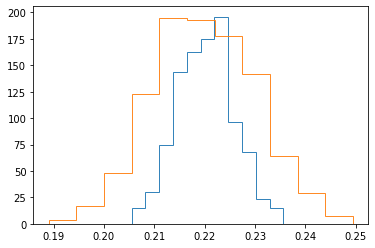

In [40]:
pct_50, pct_75 = simulate_cuts(1000, random=True)
np.mean(pct_50), np.mean(pct_75)

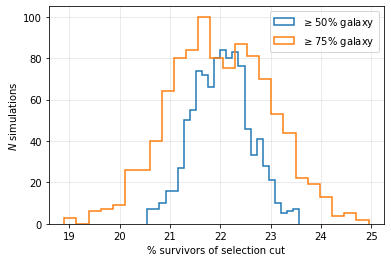

In [41]:
kw = dict(histtype='step', bins=25, lw=1.5)

fig, fr = plt.subplots()
fr.hist(100*pct_50, **kw, label='$\geq 50\%$ galaxy')
fr.hist(100*pct_75, **kw, label='$\geq 75\%$ galaxy')

fr.update(dict(
    xlabel='% survivors of selection cut',
    ylabel='$N$ simulations'
))
fr.grid(alpha=0.3)
fr.legend()

In [42]:
print(100*np.std(pct_75), 100*np.std(pct_50), 100*np.mean(pct_75), 100*np.mean(pct_50))

1.0023270441439913 0.5602619492143427 22.0014278294856 22.021542805854427


(array([407., 301., 294., 267., 251., 210., 227., 211., 140., 144., 156.,
        158., 154., 132., 142., 175., 126., 122., 164., 125., 170., 128.,
        150., 199., 232., 242., 278., 291., 279., 257., 230.]),
 array([  0.        ,   3.22580645,   6.4516129 ,   9.67741935,
         12.90322581,  16.12903226,  19.35483871,  22.58064516,
         25.80645161,  29.03225806,  32.25806452,  35.48387097,
         38.70967742,  41.93548387,  45.16129032,  48.38709677,
         51.61290323,  54.83870968,  58.06451613,  61.29032258,
         64.51612903,  67.74193548,  70.96774194,  74.19354839,
         77.41935484,  80.64516129,  83.87096774,  87.09677419,
         90.32258065,  93.5483871 ,  96.77419355, 100.        ]),
 <BarContainer object of 31 artists>)

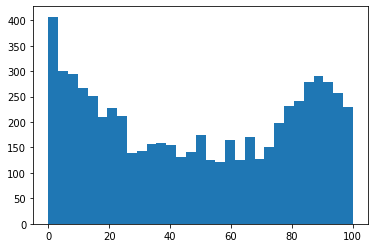

In [43]:
plt.hist(df_votes['T0 % galaxy'], bins=31)

### From `/catalogue/FDSDC.ipynb`:

In the FDSDC notebook, I match the coordinates of objects in SpaceFluff to those in the FDSDC (to within ~1''). A number of the objects in the FDSDC apparently are actually also in SpaceFluff, but by different names (in FDSDC, everything is an `FDSn_DWARFn`, whereas in SpaceFluff we name objects as `UDGcand_n`. Since the FDSDC is not strictly a UDG/LSB dwarf catalogue, we can't quite conflate the two, but the FDSDC objects _are_ Fornax cluster member dwarf galaxies, so I feel we should at least value them somewhat. If the users agree that an FDSDC galaxy is a fluffy galaxy, then I feel they succeeded in their classification.

In [44]:
# copy-pasted from FDSDC.ipynb
fdsdc_names = ['UDGcand_396', 'UDGcand_392', 'UDGcand_327', 'UDGcand_310', 'UDGcand_192', 'UDGcand_221', 'UDGcand_5290', 'UDGcand_1766', 'UDGcand_4173', 'UDGcand_1769', 'UDGcand_2779', 'UDGcand_1033', 'UDGcand_5523', 'UDGcand_5861', 'UDGcand_5270', 'UDGcand_852', 'UDGcand_1136', 'UDGcand_6436', 'UDGcand_2867', 'UDGcand_2670', 'UDGcand_795', 'UDGcand_1734', 'UDGcand_6603', 'UDGcand_4433', 'UDGcand_7265', 'UDGcand_5110', 'UDGcand_5202', 'UDGcand_1408', 'UDGcand_6245', 'UDGcand_6048', 'UDGcand_4537', 'UDGcand_2336', 'UDGcand_4344', 'UDGcand_5027', 'UDGcand_5762', 'UDGcand_1524', 'UDGcand_5853', 'UDGcand_1749', 'UDGcand_820', 'UDGcand_555', 'UDGcand_684', 'UDGcand_4046', 'UDGcand_936', 'UDGcand_1573', 'UDGcand_4436', 'UDGcand_1782', 'UDGcand_2230', 'UDGcand_6840', 'UDGcand_5427', 'UDGcand_5075', 'UDGcand_3803', 'UDGcand_5325', 'UDGcand_1491', 'UDGcand_5254', 'UDGcand_1997', 'UDGcand_2207', 'UDGcand_5354', 'UDGcand_6312', 'UDGcand_5800', 'UDGcand_5050', 'UDGcand_6517', 'UDGcand_1653', 'UDGcand_2027', 'UDGcand_2330', 'UDGcand_5735', 'UDGcand_456', 'UDGcand_3987', 'UDGcand_7261', 'UDGcand_2152', 'UDGcand_3780', 'UDGcand_1853', 'UDGcand_5375', 'UDGcand_1121', 'UDGcand_1751', 'UDGcand_6852', 'UDGcand_1130', 'UDGcand_5173', 'UDGcand_2564', 'UDGcand_5043', 'UDGcand_2020', 'UDGcand_3707', 'UDGcand_3053', 'UDGcand_4881', 'UDGcand_6019', 'UDGcand_2494', 'UDGcand_3837', 'UDGcand_879', 'UDGcand_476', 'UDGcand_2362', 'UDGcand_5192', 'UDGcand_578', 'UDGcand_2166', 'UDGcand_4002', 'UDGcand_6739', 'UDGcand_2280', 'UDGcand_6553', 'UDGcand_1582', 'UDGcand_3802', 'UDGcand_473', 'UDGcand_3392', 'UDGcand_2183', 'UDGcand_1106', 'UDGcand_4295', 'UDGcand_1119', 'UDGcand_3210', 'UDGcand_5342', 'UDGcand_5081', 'UDGcand_5826', 'UDGcand_2751', 'UDGcand_6298', 'UDGcand_6771', 'UDGcand_5579', 'UDGcand_1667', 'UDGcand_7072', 'UDGcand_5039', 'UDGcand_5062']

In [45]:
len(fdsdc_names)

116

In [46]:
survives_cut.query('name.isin(@fdsdc_names)').shape[0], fluf75.query('name.isin(@fdsdc_names)').shape[0]

(38, 39)

^ There are 39 FDSDC objects that survive our reproduction of the selection cuts. All of them are classified as fluffy galaxies by the users.

In [47]:
in_fdsdc = df_votes.query('name.isin(@fdsdc_names)')

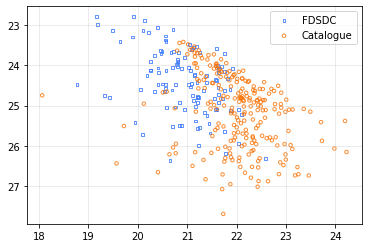

In [48]:
fig, fr = plt.subplots()

kw = dict(facecolor='none', s=8, alpha=0.8)

kw['edgecolor'] = 'xkcd:lightish blue'; kw['marker'] = 's'
fr.scatter(in_fdsdc['r'], in_fdsdc['mue_r'], **kw, label='FDSDC')

kw['edgecolor'] = 'xkcd:orange'; kw['marker'] = 'o'; kw['s'] = 12
fr.scatter(in_catalogue['r'], in_catalogue['mue_r'], **kw, label='Catalogue')
fr.legend()
fr.grid(alpha=0.3)
fr.invert_yaxis()

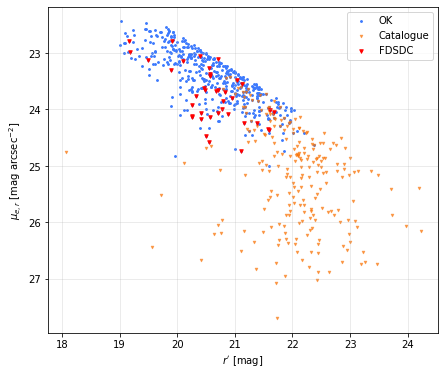

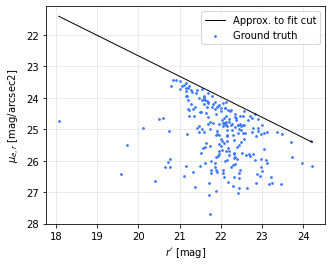

In [49]:
r, g, mue_r = get_cols(survives_cut, ['r','g','mue_r'])

fig, fr = plt.subplots(figsize=(7,6))
fr.scatter(survives_cut['r'], survives_cut['mue_r'], s=4, c='xkcd:lightish blue', alpha=1, marker='H', label='OK')
fr.scatter(in_catalogue['r'], in_catalogue['mue_r'], s=6, c='xkcd:orange', alpha=0.6, marker="v", label='Catalogue')

fluf_fdsdc = fluf75.query('name.isin(@fdsdc_names)')
fr.scatter(fluf_fdsdc['r'], fluf_fdsdc['mue_r'], s=12, marker="v", c='red', label='FDSDC')
fr.invert_yaxis()
fr.grid(alpha=0.3)
fr.legend()

fr.update(dict(xlabel=r"$r'$ [mag]", ylabel=r"$\mu_{e,r}$ [mag arcsec$^{-2}$]"))
# fr.set_xlim([21, 24])

fig, fr = plt.subplots(figsize=(5,4))
fr.scatter(in_catalogue['r'], in_catalogue['mue_r'], s=3, c='xkcd:lightish blue', label='Ground truth')
q = [0.650, 9.668]  # good approximation to catalogue
x = np.linspace(in_catalogue['r'].min(), in_catalogue['r'].max(), int(1e3))
fr.plot(x, np.polyval(q, x), ls='-', lw=1, c='black', label='Approx. to fit cut')
fr.invert_yaxis()
fr.grid(alpha=0.3)

fr.update(dict(
    xlabel='$r\'$ [mag]',
    ylabel="$\mu_{e,r}$ [mag/arcsec2]"
))

fr.legend()
plt.show()

### Inspect results for various `fluffy` thresholds:

In [50]:
cuts(df_votes.query('~RA.isnull()'))[:-1], \
cuts(gal75)[:-1], \
cuts(gal75.query('`T1 % fluffy` >= 50'))[:-1], \
cuts(gal75.query('`T1 % fluffy` >= 75'))[:-1], \
cuts(gal75.query('`T1 % fluffy` >= 90'))[:-1], \
cuts(gal75.query('`T1 % fluffy` >= 100'))[:-1]

((5440, 2269, 1230, 1196),
 (1973, 1014, 537, 532),
 (1459, 999, 534, 530),
 (1050, 859, 476, 473),
 (548, 489, 310, 310),
 (199, 192, 140, 140))

In [51]:
gal75.query('`T1 % fluffy` >= 100').query('name.isin(@catalogue_targets)').shape[0]

18

In [52]:
incatalogue.query("`T0 % galaxy` >= 50 & `T1 % fluffy` >= 75").shape[0], \
incatalogue.query("`T0 % galaxy` >= 75").shape[0]

(73, 30)

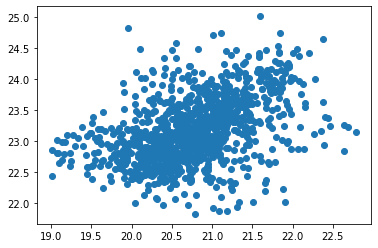

In [53]:
np.min(incatalogue['mue_r'])

plt.scatter(fluf75['r'], fluf75['mue_r'])

### Show thumbnails of fluffies that survive the cut

In [54]:
def plot_image_grid(input_df, rows, cols, title=None, savepath=None, random=True):
    size = 3*max(rows, cols)
    fig, fr = plt.subplots(rows,cols, figsize=(size, size))
    fr = np.ravel(fr)
    
    if random:
        idc = []
        while len(idc) < min([rows*cols, input_df.shape[0]]):
            idc.append(np.random.randint(0, input_df.shape[0]))

    else:
        idc = np.linspace(0, rows*cols-1, rows*cols)
        idc = idc[idc < input_df.shape[0]]
        
    # plot the images of some of these objects to see what the voters saw
    for i, name in enumerate(input_df['name'].iloc[idc]):
        object_name = name
        path = '../image/thumbnails/{}_insp.png'.format(object_name)
        image = Image.open(path)
        fr[i].imshow(image)
        fr[i].set_title(object_name)
        fr[i].set_axis_off()


    for i in range(len(fr)):
        if i >= input_df.shape[0]:
            fr[i].axis('off')
        
    if title:
        fig.suptitle(title)
    fig.tight_layout()
    
    if savepath:
        plt.savefig('./plots/{}.png'.format(savepath), dpi=125, bbox_inches='tight')
    plt.show()

In [55]:
# print("Survives selection, not in likely ground truth")
# plot_image_grid(survives_cut.query('~name.isin(@catalogue_targets)'), 4,4, savepath='selection 44 not truth.png')

# print("Survives cut, and is in likely ground truth")
# plot_image_grid(survives_cut.query('name.isin(@catalogue_targets)'), 4, 4, savepath='selection 44 in truth.png')

In [56]:
# plot_image_grid(fluf75.query('~name.isin(@catalogue_targets)'), 3, 3)

In [57]:
df_votes.query('name.isin(@catalogue_targets) & `T1 % fluffy` < 50')['T1'].apply(lambda x: sum(x.values()))

755     1
1105    9
1435    1
1491    7
1519    1
2240    2
3099    3
3870    2
Name: T1, dtype: int64

In [58]:
names, ras, decs = np.array(survives_cut.query('~name.isin(@catalogue_targets)')[['name', "RA", "DEC"]].values.tolist()).T

The following coordinates are those from objects from ^. Use them in DES cutout service and try to identify morphology from DES color images.

In [59]:
# for name, ra, dec in zip(names, ras, decs):
#     print('\'{}\','.format(name), end='')
# #     print('{} | {}, {}'.format(name, ra, dec))

In [60]:
# for ra, dec in zip(ras, decs):
#     print('{}, {}'.format(ra, dec))

For posterity, I'll save the names and coordinates of the objects I pasted to the DES cutout service. This isn't really necessary, as we can always cross-match coordinates and retrieve tiles from the summary.json file provided by the DES cutout service, however this might save time down the line:

UDGcand_396 | 55.2864151001, -36.9319725037
UDGcand_210 | 55.8758621216, -35.1862602234
UDGcand_20 | 55.3254814148, -35.4770774841
UDGcand_101 | 55.698513031, -35.4244308472
UDGcand_141 | 55.5743904114, -35.471912384
UDGcand_327 | 50.1276893616, -36.6828651428
UDGcand_106 | 55.3928108215, -35.4028053284
UDGcand_69 | 55.5672988892, -35.3390693665
UDGcand_118 | 55.8579788208, -35.6187400818
UDGcand_5 | 56.0580177307, -35.596408844
UDGcand_380 | 55.3666915894, -36.8095207214
UDGcand_337 | 49.4995117188, -36.898273468
UDGcand_17 | 56.1063041687, -35.1012802124
UDGcand_54 | 55.7846298218, -35.1467399597
UDGcand_354 | 55.9154319763, -36.0001907349
UDGcand_131 | 56.2098960876, -35.8437271118
UDGcand_0 | 56.2326087952, -35.335723877
UDGcand_163 | 55.7757453918, -35.1032218933
UDGcand_282 | 49.4652633667, -36.0546646118
UDGcand_226 | 56.311794281, -35.4601173401
UDGcand_300 | 49.7688217163, -36.4974899292
UDGcand_287 | 49.2591819763, -36.1610107422
UDGcand_129 | 56.1677780151, -35.7505874634
UDGcand_221 | 55.6788673401, -35.5406455994
UDGcand_6776 | 53.7276229858, -36.4067344666
UDGcand_6120 | 57.1812324524, -34.128452301
UDGcand_2369 | 53.7993965149, -34.5364341736
UDGcand_3480 | 56.2880859375, -34.3135490417
UDGcand_5222 | 51.6226539612, -34.0506439209
UDGcand_5163 | 52.6990699768, -34.426410675
UDGcand_1578 | 57.3510971069, -35.4724349976
UDGcand_6031 | 57.1838722229, -34.7837944031
UDGcand_1302 | 55.5672302246, -33.6948318481
UDGcand_4866 | 54.2126502991, -34.0505332947
UDGcand_1750 | 50.3312034607, -36.096912384
UDGcand_1747 | 51.5209503174, -36.2752914429
UDGcand_1451 | 55.4382400513, -33.6690750122
UDGcand_1961 | 52.4803962708, -33.8161506653
UDGcand_3390 | 56.3848114014, -34.4778137207
UDGcand_4024 | 53.5648956299, -33.2357635498
UDGcand_2424 | 52.9158325195, -34.048992157
UDGcand_1436 | 56.1326828003, -33.9285392761
UDGcand_5157 | 52.4390182495, -34.5025634766
UDGcand_6738 | 53.9096794128, -36.5229797363
UDGcand_5698 | 51.8725624084, -35.1957397461
UDGcand_6174 | 54.0545120239, -35.2237319946
UDGcand_5801 | 52.1763572693, -35.1227111816
UDGcand_852 | 53.5664138794, -35.7044868469
UDGcand_2919 | 52.8288383484, -37.7277755737
UDGcand_1654 | 51.2969322205, -36.8536491394
UDGcand_2370 | 53.5611228943, -34.9229774475
UDGcand_5938 | 56.7348861694, -34.0508804321
UDGcand_6436 | 54.6552047729, -35.9170684814
UDGcand_940 | 52.9413032532, -34.9590988159
UDGcand_2137 | 54.5131530762, -37.6100540161
UDGcand_3507 | 55.3210792542, -34.3285827637
UDGcand_2761 | 53.4867134094, -37.4583206177
UDGcand_2670 | 56.5214767456, -37.1716651917
UDGcand_3269 | 56.0609054565, -34.87707901
UDGcand_3890 | 54.1522827148, -33.1436004639
UDGcand_4066 | 53.4840164185, -33.2429962158
UDGcand_1070 | 49.8578262329, -36.9715766907
UDGcand_2191 | 54.4164161682, -37.7978210449
UDGcand_1538 | 56.5290336609, -35.7835578918
UDGcand_5972 | 56.5034561157, -34.4555130005
UDGcand_6201 | 54.782043457, -35.5000038147
UDGcand_7174 | 54.9577903748, -36.6343917847
UDGcand_5110 | 51.2250595093, -37.5983657837
UDGcand_6705 | 53.9388313293, -36.3630905151
UDGcand_1557 | 56.6907920837, -35.2897529602
UDGcand_3848 | 54.1740684509, -33.4463920593
UDGcand_1408 | 55.9231719971, -33.7425804138
UDGcand_2509 | 53.9716186523, -34.5977363586
UDGcand_2350 | 52.4766464233, -37.4465560913
UDGcand_1820 | 52.5023727417, -33.3888244629
UDGcand_6460 | 54.8436012268, -35.5898971558
UDGcand_4074 | 53.8864097595, -33.0526924133
UDGcand_2057 | 54.657207489, -37.4325675964
UDGcand_1489 | 55.3256530762, -33.647026062
UDGcand_2667 | 56.9143791199, -37.2884941101
UDGcand_2839 | 53.0848960876, -37.1146125793
UDGcand_4794 | 54.0639457703, -34.8272857666
UDGcand_4214 | 53.0831184387, -33.0219192505
UDGcand_2810 | 53.9276237488, -37.6647949219
UDGcand_432 | 55.3132286072, -36.9276199341
UDGcand_5368 | 52.2943649292, -35.9839096069
UDGcand_5798 | 52.6895484924, -35.6050376892
UDGcand_5260 | 51.9562263489, -34.4199943542
UDGcand_5121 | 51.6152572632, -34.2586021423
UDGcand_1212 | 55.6053352356, -33.8203620911
UDGcand_2855 | 53.0535926819, -37.7380218506
UDGcand_4725 | 54.5811157227, -34.7954406738
UDGcand_3057 | 55.7017173767, -34.1177406311
UDGcand_3997 | 52.9395599365, -33.199256897
UDGcand_3736 | 55.0855789185, -33.7220802307
UDGcand_1571 | 56.8909454346, -35.1462516785
UDGcand_5762 | 52.3617973328, -35.1247940063
UDGcand_4099 | 53.141418457, -33.16639328
UDGcand_5264 | 51.8043518066, -34.7598419189
UDGcand_4463 | 54.7422790527, -33.9680099487
UDGcand_684 | 53.9911880493, -35.3480148315
UDGcand_5261 | 52.1777534485, -34.1179351807
UDGcand_421 | 56.0188407898, -36.6228141785
UDGcand_1034 | 50.1159515381, -37.4005508423
UDGcand_6778 | 53.0669403076, -36.8227882385
UDGcand_7127 | 55.2144813538, -36.2187271118
UDGcand_5958 | 57.5748214722, -34.72057724
UDGcand_6513 | 54.3264045715, -35.4156608582
UDGcand_2443 | 53.9896812439, -34.5900611877
UDGcand_5323 | 51.6620903015, -36.2757263184
UDGcand_5142 | 52.3915214539, -34.1208763123
UDGcand_7180 | 54.7769050598, -36.2743034363
UDGcand_1002 | 53.4058532715, -35.2862968445
UDGcand_5361 | 52.2193984985, -35.9561195374
UDGcand_5427 | 51.6373710632, -36.9172782898
UDGcand_3729 | 54.1071243286, -33.035987854
UDGcand_2647 | 57.3848762512, -37.1302947998
UDGcand_3296 | 55.4721679688, -34.8809547424
UDGcand_4225 | 53.5840873718, -33.6025238037
UDGcand_1822 | 51.9404945374, -33.2224235535
UDGcand_2220 | 52.072845459, -37.9184761047
UDGcand_7068 | 54.3816337585, -35.9670295715
UDGcand_653 | 55.3700866699, -36.0499153137
UDGcand_1886 | 52.1049537659, -33.4687271118
UDGcand_1911 | 52.7128410339, -33.8302841187
UDGcand_6055 | 56.8319320679, -34.0808410645
UDGcand_828 | 52.8172416687, -35.6382217407
UDGcand_2363 | 53.7670326233, -34.4328269958
UDGcand_2758 | 53.6541595459, -36.9724006653
UDGcand_1150 | 55.9172363281, -33.9191513062
UDGcand_2293 | 52.7775497437, -37.5830421448
UDGcand_1194 | 56.3627624512, -33.4032363892
UDGcand_691 | 53.8118057251, -35.4260559082
UDGcand_6685 | 53.460559845, -36.0225982666
UDGcand_5254 | 52.2105522156, -34.835018158
UDGcand_1536 | 56.6283187866, -35.3035926819
UDGcand_4703 | 54.590045929, -34.2665901184
UDGcand_3410 | 55.4795608521, -34.668006897
UDGcand_5800 | 51.7096061707, -35.2739372253
UDGcand_412 | 56.3531036377, -36.2022705078
UDGcand_1660 | 51.4180831909, -36.7597503662
UDGcand_1653 | 50.9728088379, -36.9231376648
UDGcand_1248 | 56.2097740173, -33.5046806335
UDGcand_5263 | 52.3612174988, -34.2037086487
UDGcand_1439 | 55.4518585205, -33.1261787415
UDGcand_3866 | 54.5607261658, -33.1623573303
UDGcand_2655 | 57.3429374695, -37.122428894
UDGcand_2310 | 52.7495651245, -37.5227890015
UDGcand_2918 | 53.0609321594, -37.1968536377
UDGcand_5045 | 50.4908714294, -37.7418823242
UDGcand_1079 | 49.8432006836, -37.5872344971
UDGcand_5837 | 52.0360412598, -35.0967025757
UDGcand_6052 | 57.4122886658, -34.3056983948
UDGcand_729 | 53.3336448669, -35.4439277649
UDGcand_2876 | 53.5620765686, -37.7766647339
UDGcand_2497 | 53.8723754883, -34.2437820435
UDGcand_3226 | 56.1412010193, -34.3367271423
UDGcand_6409 | 54.1291465759, -35.7655792236
UDGcand_3127 | 55.7652130127, -34.6463050842
UDGcand_1262 | 55.5961303711, -33.3880958557
UDGcand_6651 | 52.9322967529, -36.2446289062
UDGcand_4170 | 52.8923225403, -33.4172859192
UDGcand_2182 | 54.8243675232, -36.9620819092
UDGcand_4228 | 54.7993927002, -34.3059616089
UDGcand_3717 | 54.4042854309, -33.2364349365
UDGcand_6760 | 53.0036277771, -36.1153831482
UDGcand_4617 | 55.1934089661, -34.0779380798
UDGcand_6129 | 56.5921173096, -34.5201072693
UDGcand_2179 | 54.3509101868, -37.0947151184
UDGcand_2152 | 54.9100532532, -37.709777832
UDGcand_5577 | 52.1506958008, -35.4700775146
UDGcand_4752 | 54.7374000549, -34.5541343689
UDGcand_5151 | 52.560710907, -34.1956443787
UDGcand_4958 | 54.656337738, -34.9035415649
UDGcand_5073 | 51.4204139709, -37.5995063782
UDGcand_1853 | 52.37159729, -33.4517593384
UDGcand_5375 | 51.7065696716, -36.7475471497
UDGcand_637 | 56.0594940186, -36.7514076233
UDGcand_4331 | 54.2752342224, -34.7857894897
UDGcand_3043 | 56.3929824829, -33.9769325256
UDGcand_682 | 53.479839325, -35.1744880676
UDGcand_2231 | 52.5985679626, -37.5799789429
UDGcand_3749 | 54.7912940979, -33.2734870911
UDGcand_2590 | 53.6691551208, -34.4174041748
UDGcand_6852 | 53.7889251709, -36.2698326111
UDGcand_1094 | 49.5761985779, -37.8980407715
UDGcand_2144 | 54.9499168396, -37.7076301575
UDGcand_5166 | 52.7418212891, -34.7760467529
UDGcand_2068 | 54.269695282, -37.9035758972
UDGcand_2960 | 56.0842704773, -34.2707252502
UDGcand_5645 | 52.3407974243, -35.6854667664
UDGcand_6449 | 54.4001045227, -35.8425750732
UDGcand_5043 | 50.8686141968, -37.8478889465
UDGcand_3253 | 55.7237968445, -34.3108863831
UDGcand_1314 | 55.3585319519, -33.4349212646
UDGcand_6024 | 56.9623413086, -34.6241416931
UDGcand_2020 | 54.1048698425, -37.1252593994
UDGcand_1735 | 50.8760490417, -36.4962463379
UDGcand_5597 | 51.8437728882, -35.2085990906
UDGcand_6297 | 54.7430076599, -35.1195983887
UDGcand_434 | 56.3451080322, -36.502532959
UDGcand_6597 | 55.2069816589, -35.6363182068
UDGcand_1799 | 52.3956718445, -33.1409072876
UDGcand_2121 | 55.2315101624, -37.80727005
UDGcand_769 | 53.0678405762, -35.3672523499
UDGcand_855 | 53.9757156372, -35.9392280579
UDGcand_3837 | 54.659488678, -33.8976821899
UDGcand_5242 | 51.8368606567, -34.3896369934
UDGcand_4760 | 55.0366287231, -34.9180984497
UDGcand_5152 | 52.5177841187, -34.0471725464
UDGcand_2619 | 53.7459259033, -34.2872962952
UDGcand_4966 | 54.6190834045, -34.6896743774
UDGcand_476 | 55.5918464661, -36.447353363
UDGcand_6717 | 52.9077224731, -36.7685508728
UDGcand_1063 | 49.3439064026, -37.7894477844
UDGcand_2419 | 53.8068695068, -34.9024620056
UDGcand_6178 | 54.3498878479, -35.698097229
UDGcand_1826 | 52.5679969788, -33.811000824
UDGcand_5515 | 52.339717865, -35.7218399048
UDGcand_766 | 53.4762229919, -35.5040359497
UDGcand_3646 | 54.8866195679, -33.2185173035
UDGcand_2196 | 51.7878646851, -37.7350502014
UDGcand_5507 | 52.2130241394, -35.6921195984
UDGcand_4917 | 54.3358764648, -34.8993530273
UDGcand_4087 | 53.4753189087, -33.6503219604
UDGcand_5445 | 51.6055526733, -36.9202041626
UDGcand_5124 | 52.0400314331, -34.3571815491
UDGcand_6042 | 57.6242790222, -34.5124740601
UDGcand_4972 | 54.2989387512, -33.9766044617
UDGcand_2077 | 54.941696167, -37.3761367798
UDGcand_3185 | 55.9402198792, -34.9101524353
UDGcand_750 | 53.289932251, -35.234462738
UDGcand_4341 | 54.8784141541, -34.617816925
UDGcand_3986 | 53.1872177124, -33.4270057678
UDGcand_4965 | 54.8299293518, -34.6386489868
UDGcand_505 | 55.6658935547, -36.7467155457
UDGcand_473 | 55.3477287292, -36.6537742615
UDGcand_609 | 55.3670196533, -36.4900817871
UDGcand_4557 | 54.4417381287, -34.6158027649
UDGcand_1381 | 56.247631073, -33.8254890442
UDGcand_2684 | 56.6777877808, -37.4665260315
UDGcand_538 | 56.3954353333, -36.3392295837
UDGcand_5810 | 52.0990905762, -34.97681427
UDGcand_4276 | 55.0851325989, -34.2884140015
UDGcand_4997 | 50.7894363403, -37.7367286682
UDGcand_3467 | 56.0176429749, -34.5416526794
UDGcand_2105 | 54.2466964722, -37.9206581116
UDGcand_2661 | 56.8482780457, -37.3468055725
UDGcand_1165 | 56.0746688843, -33.0052642822
UDGcand_1313 | 55.2670326233, -33.5875892639
UDGcand_6871 | 53.3517532349, -36.3096618652
UDGcand_1106 | 49.9676246643, -37.0080604553
UDGcand_1772 | 50.5166854858, -36.1868095398
UDGcand_6058 | 56.8098869324, -34.0758018494
UDGcand_3139 | 56.1057548523, -34.4096679688
UDGcand_2823 | 52.8006362915, -37.235786438
UDGcand_6856 | 53.0169715881, -36.3223419189
UDGcand_913 | 53.4300498962, -35.187461853
UDGcand_5342 | 51.9301605225, -36.0163879395
UDGcand_5994 | 56.9890785217, -34.780582428
UDGcand_1837 | 52.4970436096, -33.0798416138
UDGcand_5193 | 51.6138420105, -34.0258140564
UDGcand_3194 | 56.0955352783, -34.4227561951
UDGcand_1051 | 49.466632843, -37.7768630981
UDGcand_6542 | 54.5605163574, -35.2723579407
UDGcand_6253 | 54.4834251404, -35.5862045288
UDGcand_5349 | 52.2649078369, -36.0860366821
UDGcand_1979 | 51.8791007996, -33.1298065186
UDGcand_1359 | 55.811920166, -33.6940460205
UDGcand_1520 | 57.3668518066, -35.2839355469
UDGcand_711 | 52.8593902588, -35.3103485107
UDGcand_4870 | 54.9434928894, -34.1343994141
UDGcand_417 | 55.6179122925, -36.2220649719
UDGcand_6406 | 54.9455795288, -35.5315322876
UDGcand_4330 | 54.6449165344, -34.1159858704
UDGcand_2339 | 52.7072906494, -37.0416793823
UDGcand_1423 | 56.1369934082, -33.0800323486
UDGcand_3106 | 55.3685874939, -34.6387443542
UDGcand_7069 | 55.0600585938, -35.9673995972
UDGcand_462 | 55.7936019897, -36.27161026
UDGcand_5118 | 51.7703132629, -34.8564529419
UDGcand_5039 | 50.7984657288, -37.8370513916
UDGcand_2612 | 53.5515480042, -34.0165405273
UDGcand_7051 | 54.1580047607, -36.6750640869
UDGcand_1371 | 56.0681915283, -33.0443572998
UDGcand_2197 | 52.5919036865, -37.3882865906
UDGcand_5062 | 51.505153656, -37.5703697205

## Create image grid of objects _not_ in LGT catalogue, but that are classified as fluffy galaxies.

We do this in order to identify any objects that don't show clear spiral structure or bulges, and thus could conceivable by included in the LGT catalogue in our opinion. Of course they would first require visual inspection by an expert, and perhaps they can be excluded from cluster membership on the basis of parameters not available to us.

- Plot images every single object in the LGT (in 5x5 grids), save as `./plots/incatalogue-chunk_n.png`
- Plot images of the fluffy galaxies as voted by users (75% thresholds) that survive selection cuts, but aren't in the LGT catalogue, and save as `./plots/to_inspect-chunk_n.png`
- Compare side-by-side these images to see if any in the second set look like they might belong in the first set.
    - Write down names of these objects.
    - Put them in a list.
    - Compare properties (surface brightness, etc.) of these objects to those in the LGT catalogue.
    
    Do this twice. First create a loose initial guess, then tighten the range based on a second look. We'll save the 'survivors' of the first pass to `./plots/2nd_pass-chunk_n.png`

In [61]:
q = "\
    ~name.isin(@catalogue_targets) &\
    `T0 % galaxy` >= 75 &\
    `T1 % fluffy` >= 75 \
"

In [62]:
to_inspect = survives_cut.query(q)

#### Save image grids of catalogue objects:

In [63]:
chunks = []

for i in range(10):
    idc = np.linspace(i*25, i*25+24, 25)
    idc = idc[idc < incatalogue.shape[0]]
    chunk = incatalogue.iloc[idc]
    chunks.append(chunk)
    
# # uncomment to generate image grids. this can take up to a minute or so
# for i, chunk in enumerate(chunks):
#     plot_image_grid(chunk, 5, 5, savepath="./incatalogue-chunk_{}".format(i), random=False)

In [64]:
to_inspect['mue_r'].max()

25.0068340302

## Save image grids of objects in catalogue that are at least as bright as the faintest object detected by the users as fluffy galaxies (that also survive selection cuts):

In [65]:
chunks = []

incatalogue_bright = incatalogue.query('mue_r <= 25')

for i in range(5):
    idc = np.linspace(i*25, i*25+24, 25)
    idc = idc[idc < incatalogue_bright.shape[0]]
    chunk = incatalogue_bright.iloc[idc]
    chunks.append(chunk)
    
# # uncomment to generate image grids. this can take up to a minute or so
# for i, chunk in enumerate(chunks):
#     plot_image_grid(chunk, 5, 5, savepath="./incatalogue_bright-chunk_{}".format(i), random=False)

In [66]:
chunks = []

for i in range(10, 18):
    idc = np.linspace(i*25, i*25+24, 25)
    idc = idc[idc < to_inspect.shape[0]]
    chunk = to_inspect.iloc[idc]
    chunks.append(chunk)

# # uncomment to generate image grids. this can take up to a minute or so
# for i, chunk in enumerate(chunks):
#     plot_image_grid(chunk, 5, 5, savepath="./to_inspect-chunk_{}".format(i+10), random=False)

### After the first pass, I believe the following objects might warrant a second look:

In [67]:
to_inspect.shape[0]

445

In [68]:
warrants_second_look = [
    396, 210, 141, 327, 106, 380, 163, 282, 226, 221, 3390, 4024, 1436, 6738, 852, 6436, 2966, 4805, 1719, 5110, 1408, 
    1820, 6460, 3673, 4214, 2810, 432, 5121, 1212, 3736, 1571, 5264, 6747, 555, 684, 7127, 5142, 1002, 3729, 6055, 2363, 2758,
    1150, 1057, 6685, 4703, 412, 3410, 2508, 1248, 5263, 2497, 3226, 6052,
    2182, 4228, 3717, 6129, 4904, 637, 5173, 4331, 3253, 6024, 434, 4881, 3837, 5242, 4966, 476, 5124, 7060, 2077, 3185, 2280,
    4341, 609, 4557, 5810, 4276, 2105, 1313, 1106, 6058, 5994, 1837, 3194, 6253, 1979, 4870, 2339, 1370, 7069, 7051, 5062
]

Of the 445 objects we looked at, the first loose pass leaves 95.

## Create image grid of the objects remaining after our first pass comparison:

In [69]:
for val in [136, 5290, 1766, 2779, 3195, 2230, 2109, 3279, 3333]:  # this is an additional list of objects
      # that we obtain if we look at the objects resulting from excluding the first 50 votes per user
        # (see end of this notebook)
    warrants_second_look.append(val)
    
print('Number of objects that survive our first inspection:', len(warrants_second_look))
first_pass_names = ['UDGcand_{}'.format(int(identifier)) for identifier in warrants_second_look]

Number of objects that survive our first inspection: 104


In [70]:
df_first_pass = df_votes.query('name.isin(@first_pass_names)')

## Create image grids of these 95 objects:

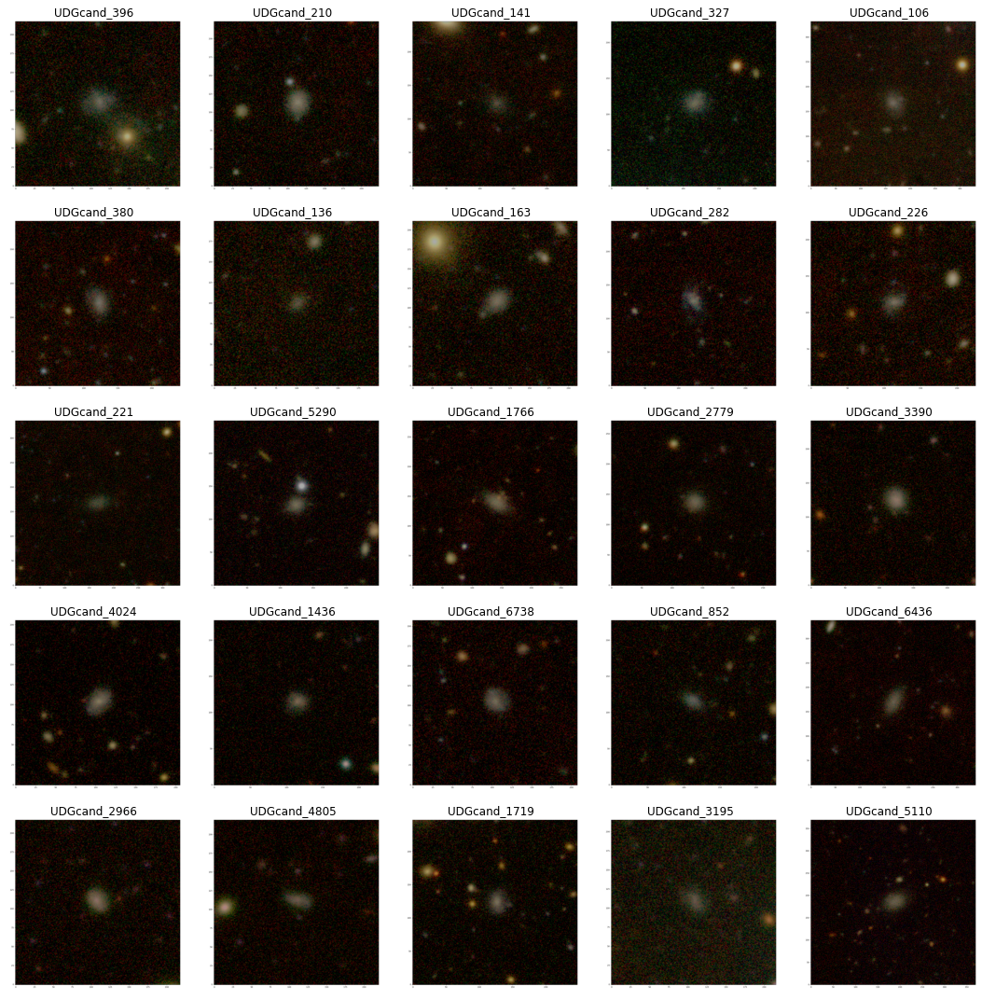

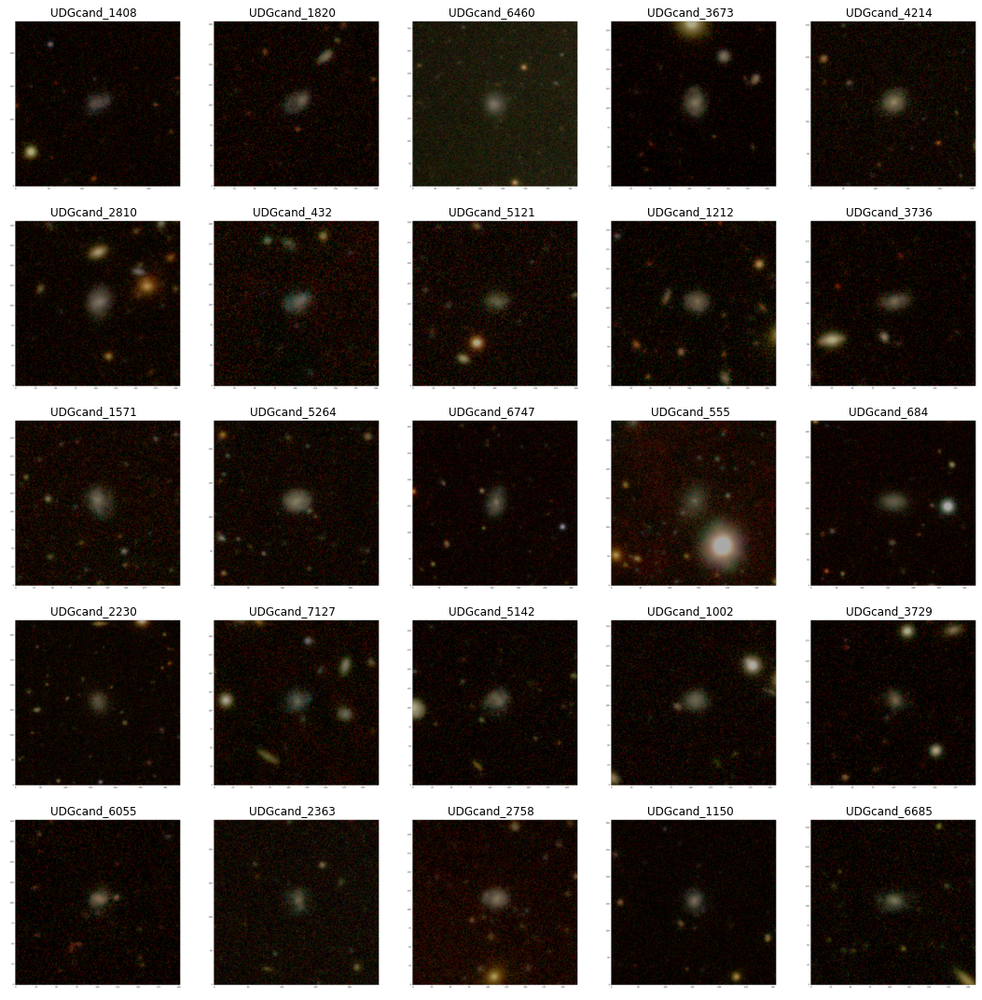

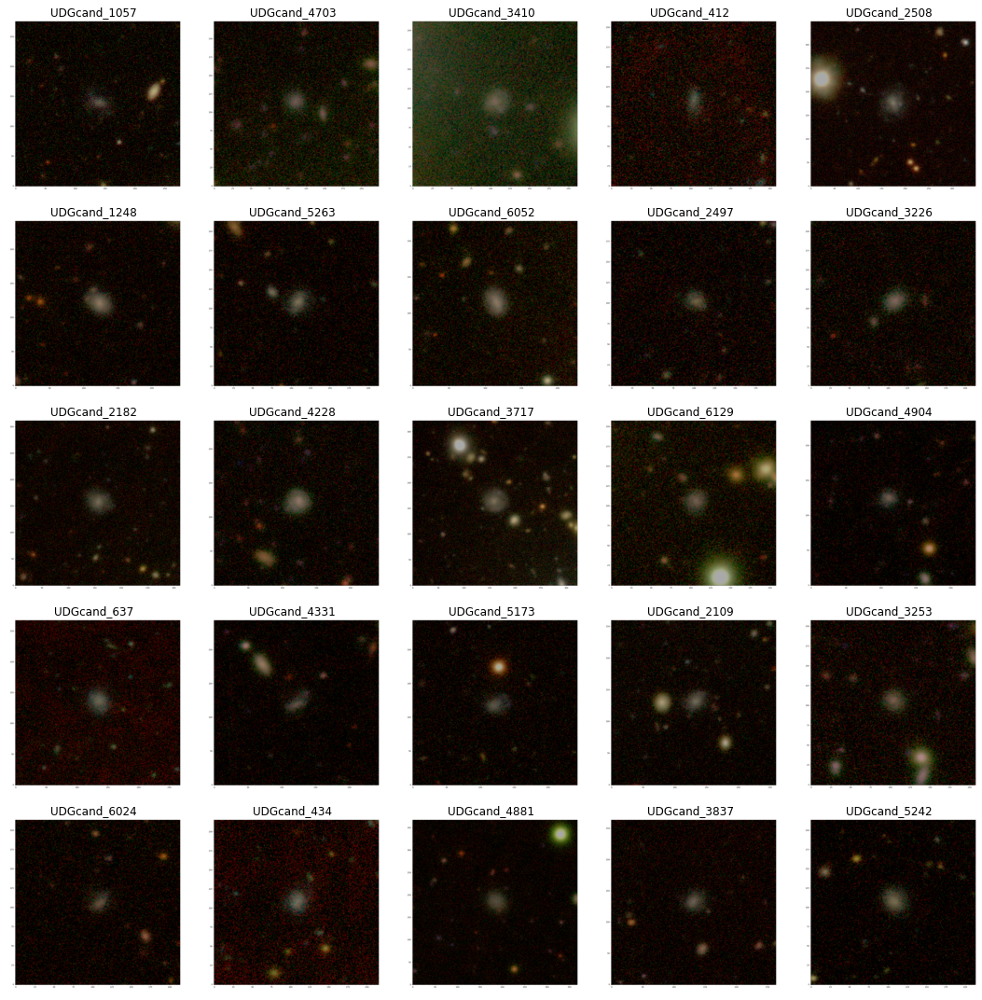

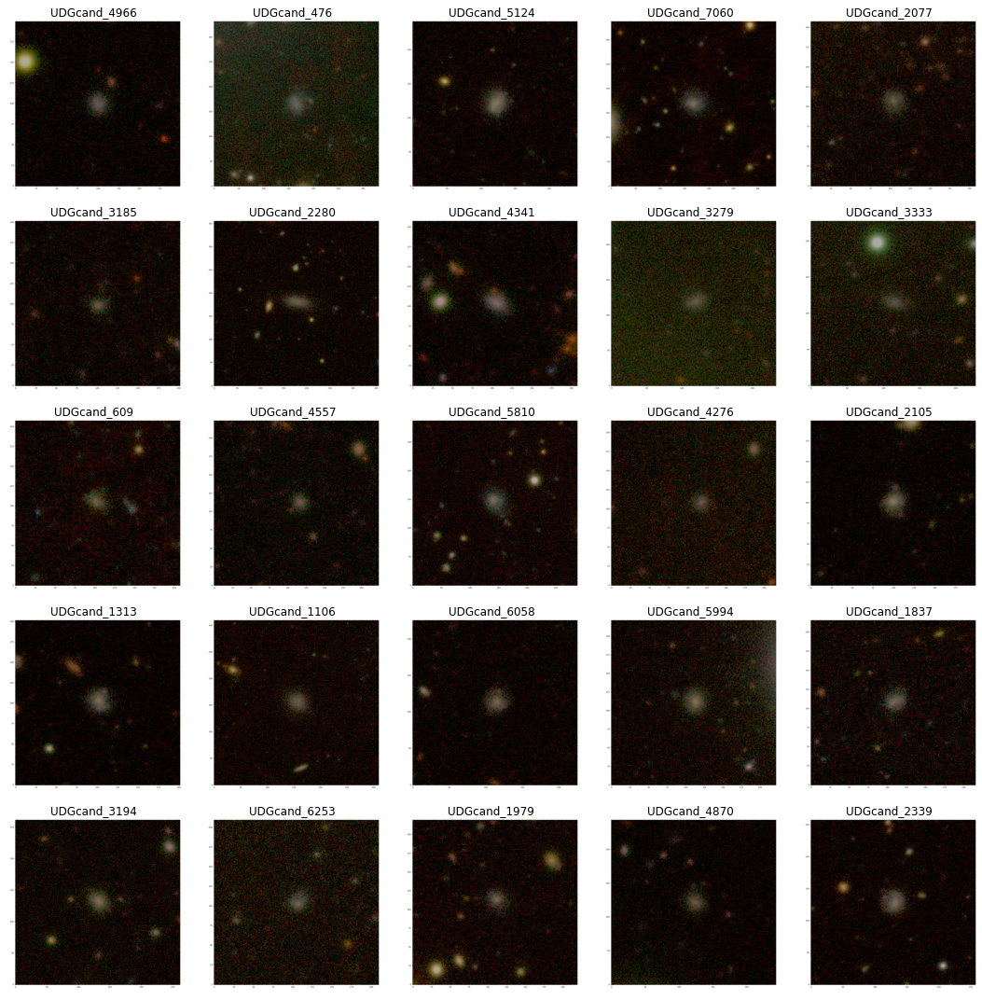

In [71]:
chunks = []

for i in range(4):
    idc = np.linspace(i*25, i*25+24, 25)
    idc = idc[idc < df_first_pass.shape[0]]
    chunk = df_first_pass.iloc[idc]
    chunks.append(chunk)

# uncomment to generate image grids. this can take up to a minute or so
for i, chunk in enumerate(chunks):
    plot_image_grid(chunk, 5, 5, savepath="./2nd_pass-chunk_{}".format(i), random=False)

## Comparing `2nd_pass` images to `incatalogue_bright` images:

We see a few objects that show clear structure, we list them below. The remaining objects are all fuzzy enough or similar enough to objects that _are_ in the catalogue that we believe they could be included in the catalogue, if we base the decision only on the photometric properties and our visual inspection of the image. Again, additional parameters might rule out their cluster membership, but we do not have access to any more information about the objects.

In [72]:
exclude_after_2nd_pass = [210, 3390, 380, 4024, 3673, 4214, 2966, 6738, 6460, 555, 2758, 1248, 6055, 5264, 2508, 4228, 5263, 6052, 1370, 3717, 7060, 5124]
exclude_after_2nd_pass_names = ['UDGcand_{}'.format(int(identifier)) for identifier in exclude_after_2nd_pass]

In [73]:
print('Number of objects that survived our first look, but not our second:', len(exclude_after_2nd_pass))

Number of objects that survived our first look, but not our second: 22


In [74]:
df_second_pass = df_first_pass.query('~name.isin(@exclude_after_2nd_pass_names)')

## Compare photometric parameters between LGT, selection cut survivors, and the survivors of our first inspection:

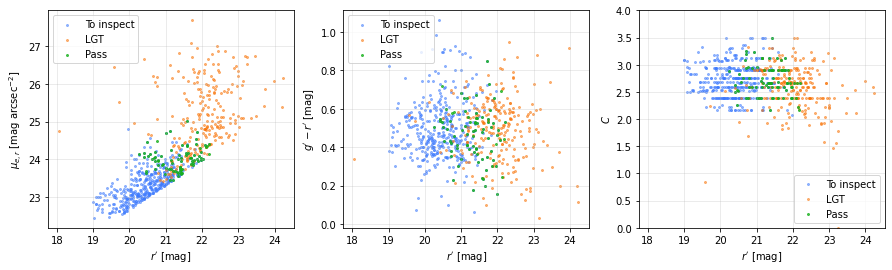

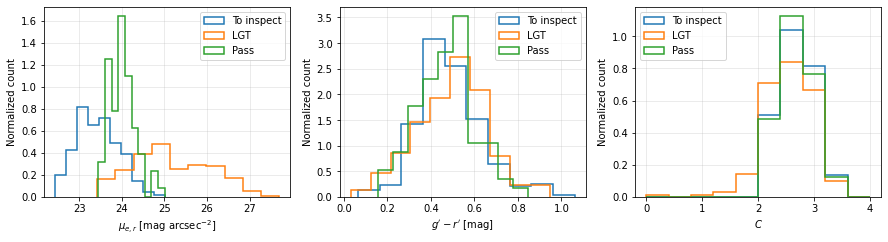

In [75]:
fig, fr = plt.subplots(1,3, figsize=(15,4))

kw = dict(alpha=0.5, s=4)

labels = ['To inspect', 'LGT', 'Pass']
# markers = ['D', 'v', 'o']
colors = ['xkcd:lightish blue', 'xkcd:orange', 'xkcd:green']
alphas = [0.5, 0.5, 0.75]

for i, slice in enumerate([to_inspect, incatalogue, df_second_pass]):
    kw['label'] = labels[i]
#     kw['marker'] = markers[i]
    kw['color'] = colors[i]
    kw['alpha'] = alphas[i]
    fr[0].scatter(slice['r'], slice['mue_r'], **kw)
    fr[1].scatter(slice['r'], slice['g']-slice['r'], **kw)
    fr[2].scatter(slice['r'], slice['C'], **kw)
    
for i in range(3):
    fr[i].grid(alpha=0.3)
    fr[i].legend()
    fr[i].update(dict(xlabel="$r'$ [mag]"))

fr[2].update(dict(
    ylim=[0,4]
))

fr[0].update(dict(ylabel=r'$\mu_{e,r}$ [mag arcsec$^{-2}$]'))
fr[1].update(dict(ylabel="$g' - r'$ [mag]"))
fr[2].update(dict(ylabel="$C$"))

plt.savefig('./plots/manual_parameter-space', dpi=200, bbox_inches='tight')

hist_kw = dict(lw=1.5, histtype='step', facecolor='none', density=True)

fig, fr = plt.subplots(1,3, figsize=(15,3.5))
for i, slice in enumerate([to_inspect, incatalogue, df_second_pass]):
    hist_kw['label'] = labels[i]
    fr[0].hist(slice['mue_r'], **hist_kw)
    fr[1].hist(slice['g']-slice['r'], **hist_kw)
    fr[2].hist(slice['C'], **hist_kw, range=[0,4])

for i in range(3):
    fr[i].grid(alpha=0.3)
    
    loc = 'upper right' if i < 2 else 'upper left'
    fr[i].legend(loc=loc)
    
fr[0].update(dict(
    xlabel=r'$\mu_{e,r}$ [mag arcsec$^{-2}$]'
))

fr[1].update(dict(
    xlabel="$g' - r'$ [mag]"
))

fr[2].update(dict(
    xlabel="$C$"
))

for i in range(3):
    fr[i].update(dict(ylabel="Normalized count"))
    

plt.savefig('./plots/manual_histograms', dpi=200, bbox_inches='tight')

### Plot images of objects we believe might still be included in the LGT catalogue, and images of objects that actually are in the LGT catalogue

Note that rerunning this cell will produce a new randomized subset, since we randomize the indices of the dataframe we display:

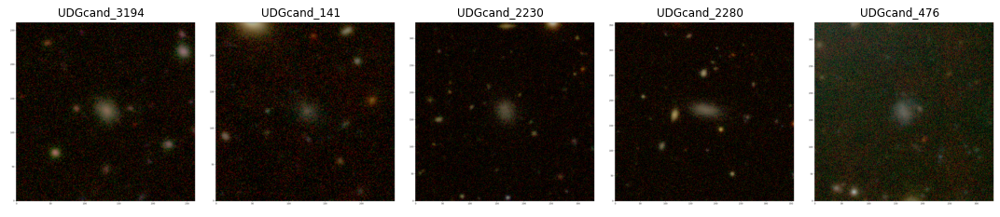

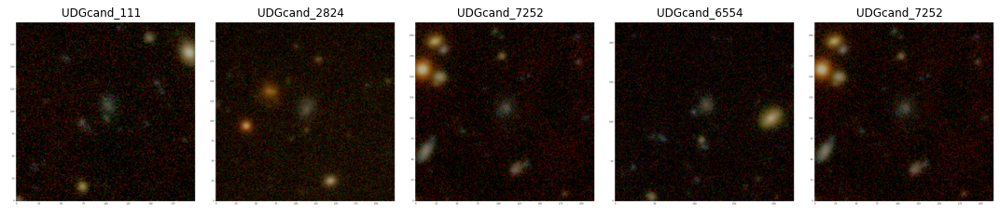

In [76]:
plot_image_grid(df_second_pass, 1, 5, savepath="./possible_members".format(i), random=True)
plot_image_grid(incatalogue_bright, 1, 5, savepath="./bright_catalogue".format(i), random=True)

### Plot images of a few of the LGT objects with $\mu_{e,r} > 26$ mag/arcsec$^2$:

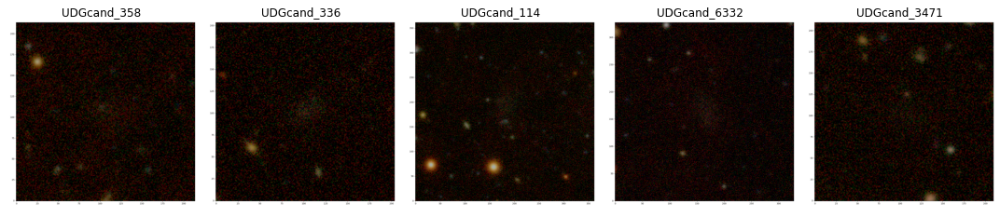

57      4.0
149    10.7
232    10.3
406     5.3
577     2.9
Name: T0 % galaxy, dtype: float64

In [77]:
plot_image_grid(incatalogue.query('mue_r > 26'), 1, 5, savepath="./faint_catalogue".format(i), random=False)

incatalogue.query('mue_r > 26').head(5)['T0 % galaxy']

In [78]:
# print number of objects in catalogue, with mu > 25 mag/arsec^2, that get at least 50% of their T0 votes for 'galaxy'
df_votes.query('mue_r >= 25 & `T0 % galaxy` >= 50 & name.isin(@catalogue_targets)').shape[0]

7

In [79]:
# print names of potential candidates remaining after our own manu classification
#  this list will go in the appendix. should also put the complete image grids in there, as this is one of the main results of the thesis
for name in df_second_pass['name'].tolist():
    if name not in fdsdc_names:
        print("\item[] {}".format(name.split('_')[-1]))

\item[] 141
\item[] 106
\item[] 136
\item[] 163
\item[] 282
\item[] 226
\item[] 1436
\item[] 4805
\item[] 1719
\item[] 3195
\item[] 1820
\item[] 2810
\item[] 432
\item[] 5121
\item[] 1212
\item[] 3736
\item[] 1571
\item[] 6747
\item[] 7127
\item[] 5142
\item[] 1002
\item[] 3729
\item[] 2363
\item[] 1150
\item[] 6685
\item[] 1057
\item[] 4703
\item[] 3410
\item[] 412
\item[] 2497
\item[] 3226
\item[] 2182
\item[] 6129
\item[] 4904
\item[] 637
\item[] 4331
\item[] 2109
\item[] 3253
\item[] 6024
\item[] 434
\item[] 5242
\item[] 4966
\item[] 2077
\item[] 3185
\item[] 4341
\item[] 3279
\item[] 3333
\item[] 609
\item[] 4557
\item[] 5810
\item[] 4276
\item[] 2105
\item[] 1313
\item[] 6058
\item[] 5994
\item[] 1837
\item[] 3194
\item[] 6253
\item[] 1979
\item[] 4870
\item[] 2339
\item[] 7069
\item[] 7051


## Perform selection cuts on set with leading votes per user excluded:

In [80]:
df_votes_ex50 = pd.read_json('df_votes_exclude_50.json')

In [81]:
cuts(df_votes_ex50.query("`T0 % galaxy` >= 75 & `T1 % fluffy` >= 75"))[:-1]

(1133, 913, 522, 520)

In [82]:
survives_cut_ex50 = cuts(df_votes_ex50.query("`T0 % galaxy` >= 75 & `T1 % fluffy` >= 75"))[-1]
survives_cut = cuts(df_votes.query("`T0 % galaxy` >= 75 & `T1 % fluffy` >= 75"))[-1]

In [83]:
survives_cut['name'].shape[0], survives_cut_ex50['name'].shape[0]

(473, 520)

### Find more fluffy galaxies that could be candidates for LGT inclusion:

In [84]:
diff = []
for name in set(survives_cut_ex50.query('~name.isin(@catalogue_targets)')['name']):
    if not name in set(survives_cut['name']):
        diff.append(name)

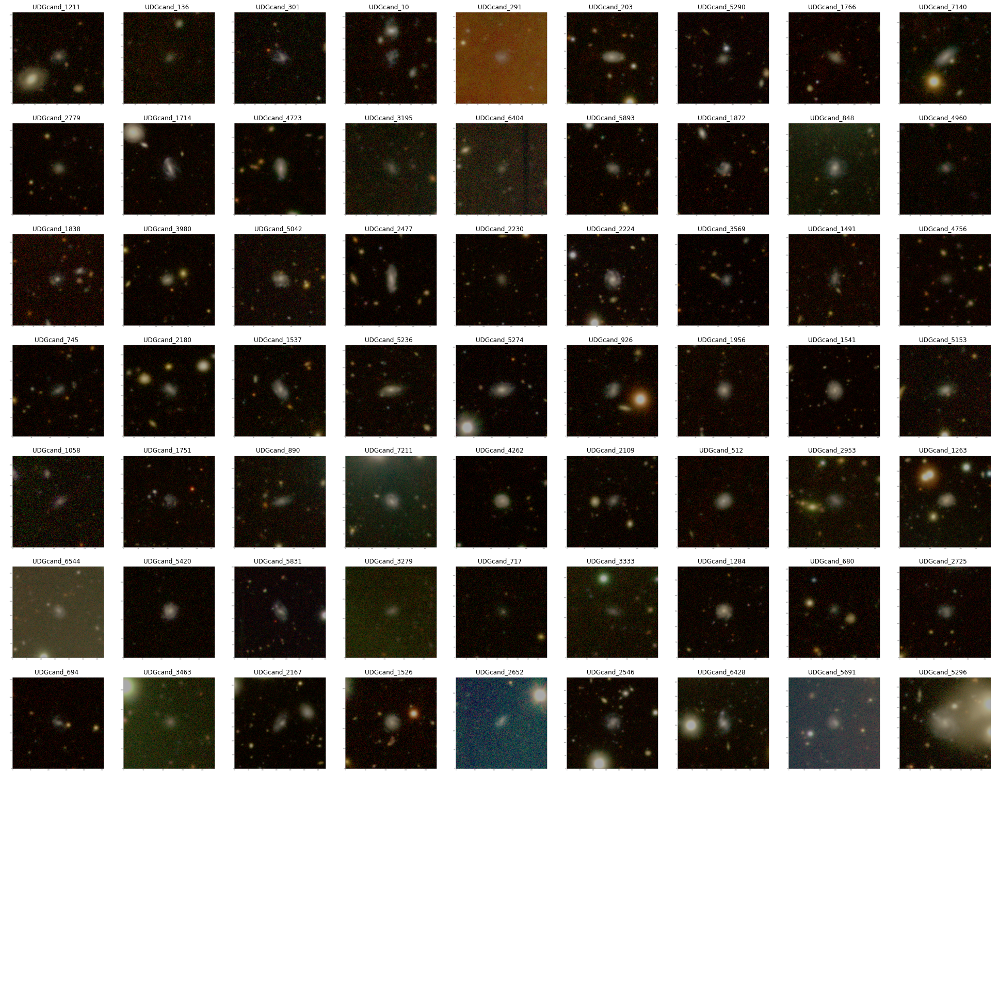

In [85]:
# plot objects that are classified as fluffy galaxies if we exclude the first 50 classifications per user, but not when we use all classifications
#  some of these might also be faint/structure-less enough to still recommend for possible inclusion in the LGT catalogue

# # uncomment to generate and save grids
plot_image_grid(df_votes.query('name.isin(@diff)'), 9,9,random=False, savepath='/inspect_ex50')

## Finally, plot image grids of all the objects we recommend for a further look for possible inclusion in the LGT catalogue:

In [86]:
candidates = df_second_pass.query('~name.isin(@fdsdc_names)')

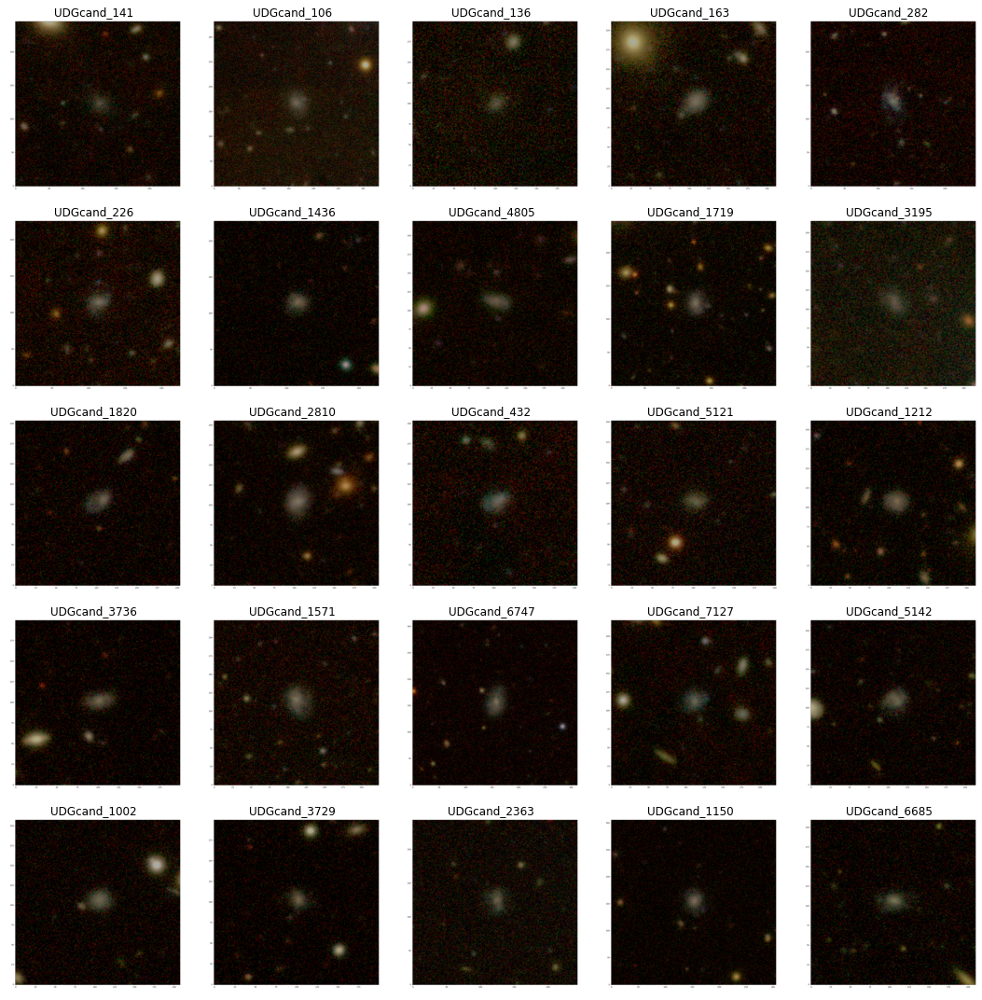

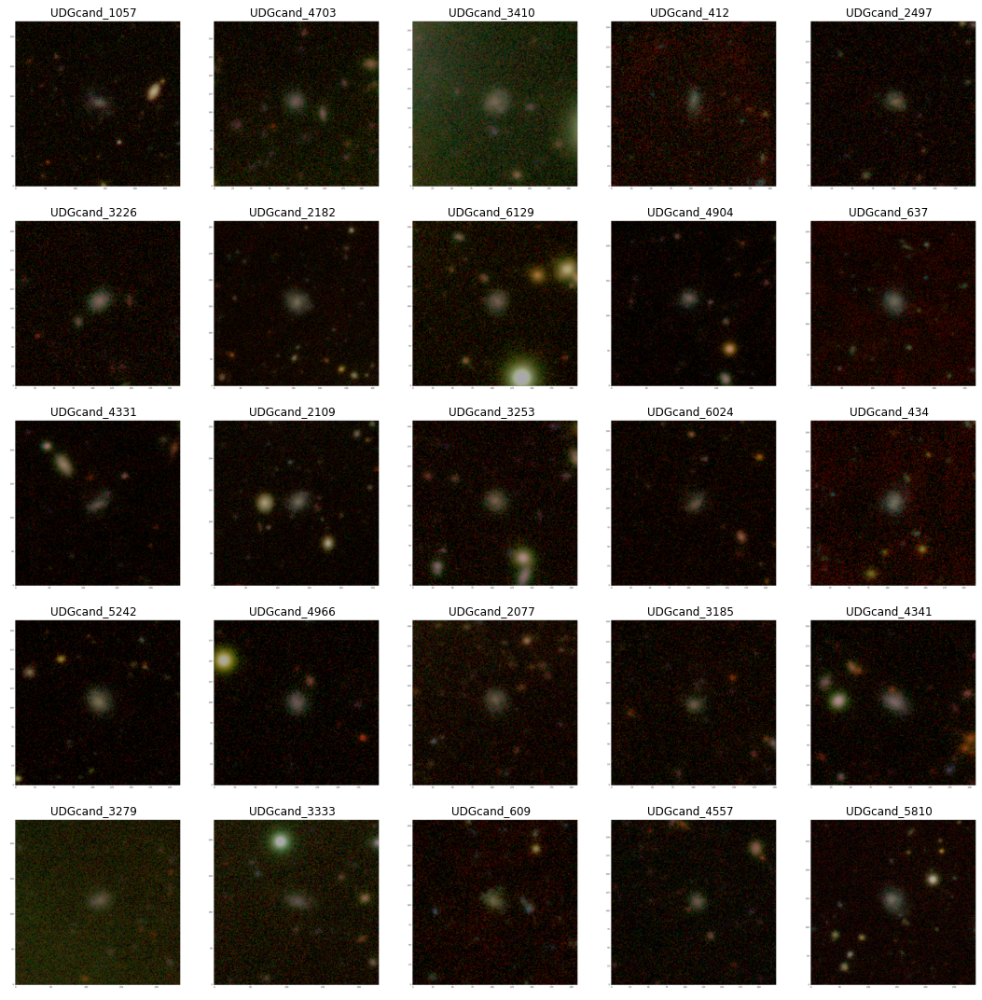

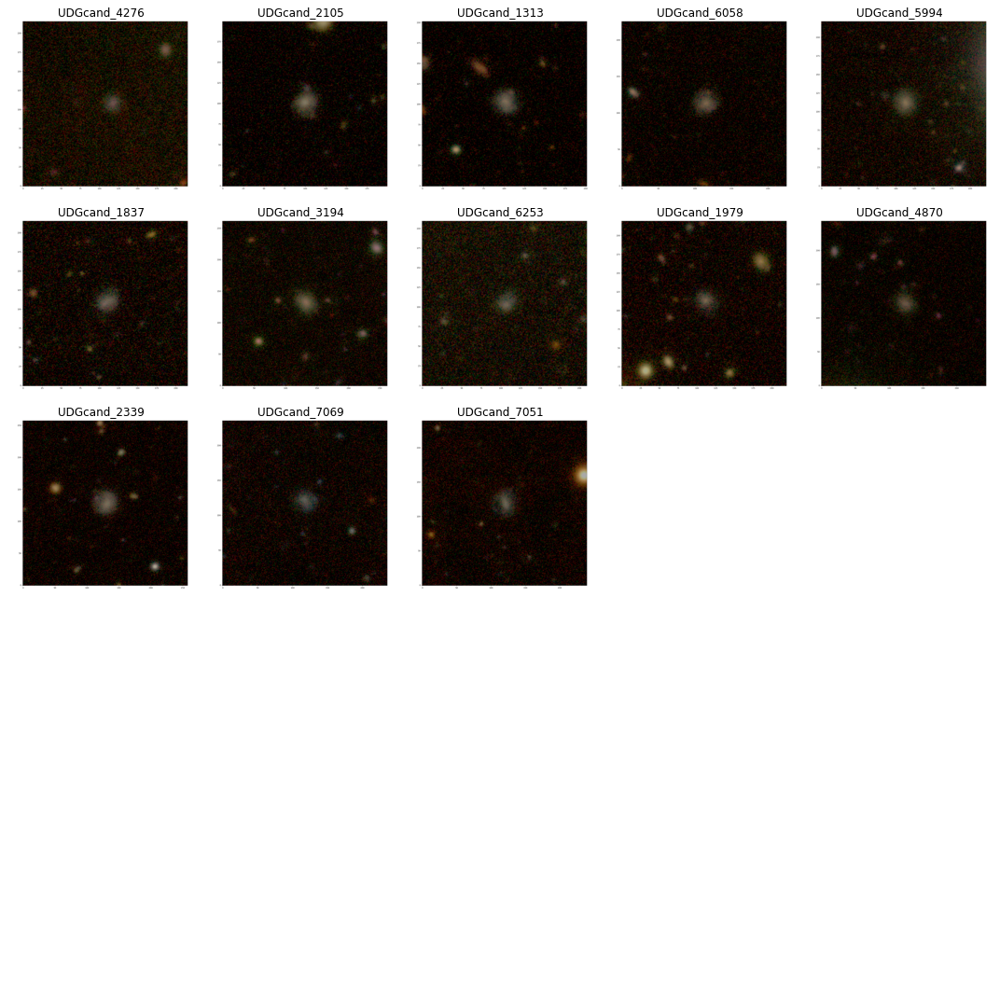

In [87]:
chunks = []

for i in range(3):
    idc = np.linspace(i*25, i*25+24, 25)
    idc = idc[idc < np.array(candidates).shape[0]]
    chunk = candidates.iloc[idc]
    chunks.append(chunk)

# # uncomment to generate and save grids  
for i, chunk in enumerate(chunks):
    plot_image_grid(chunk, 5, 5, savepath="./candidates-chunk_{}".format(i), random=False)

### Also get a 5x5 grid of LGT objects or comparison:

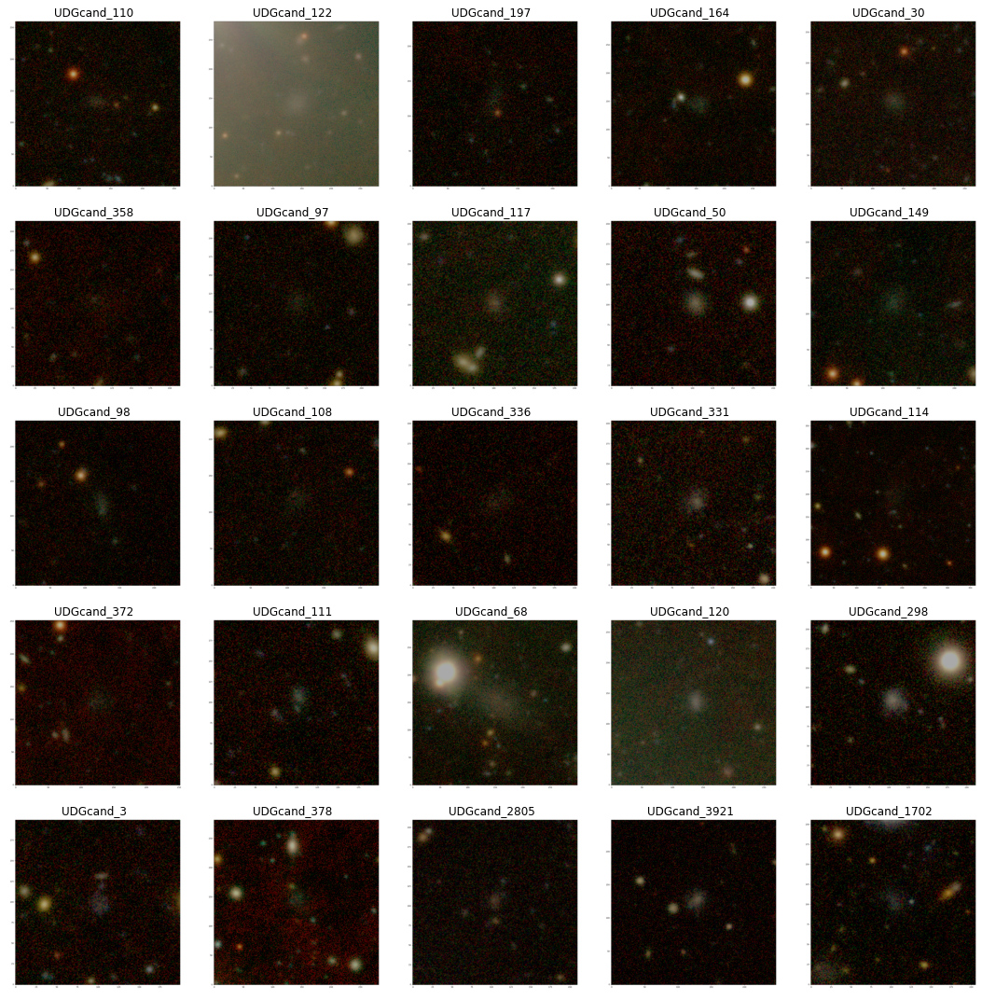

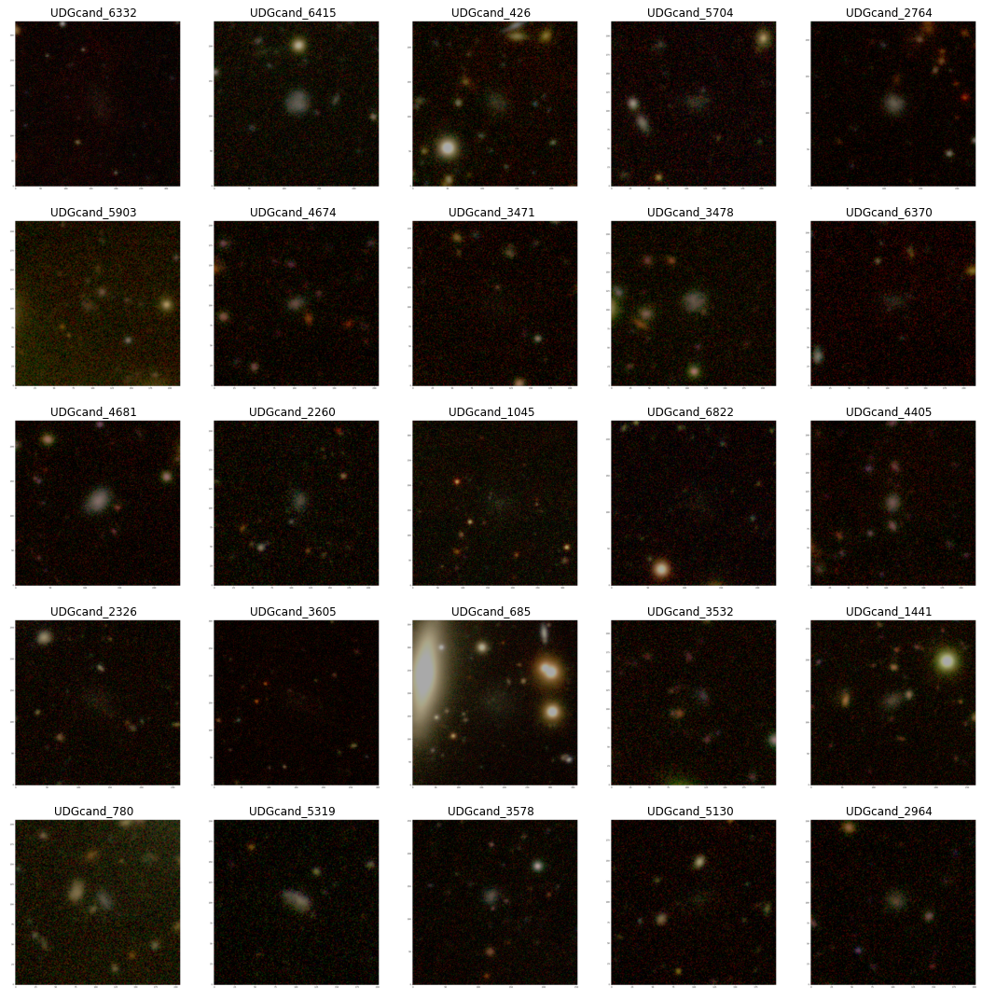

In [88]:
plot_image_grid(incatalogue.iloc[np.arange(0, 25, 1)], 5, 5, savepath='./catalogue-5x5', random=False)
plot_image_grid(incatalogue.iloc[np.arange(25, 50, 1)], 5, 5, savepath='./catalogue-5x5-1', random=False)